In [28]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [29]:
# Root directory for dataset
dataroot = "./data"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 20

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

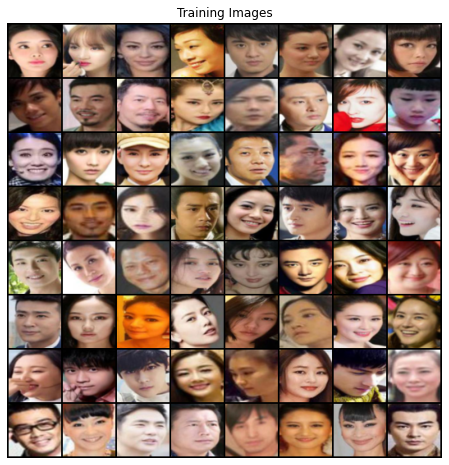

In [30]:
dataroot = "D:\Datasets\AsianFaces"

# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

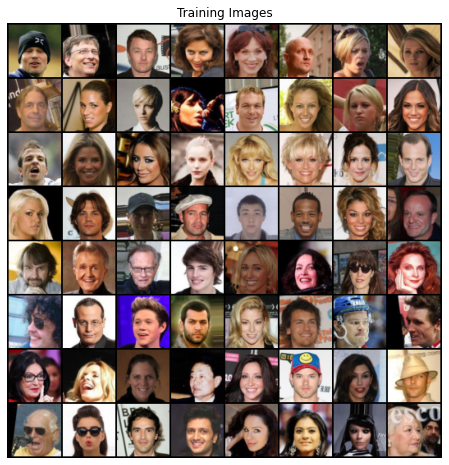

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [31]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [32]:
# Generator Code
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [33]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [34]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [35]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [36]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [37]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            torch.save(netD.state_dict(), './models/dis' + str(epoch))
            torch.save(netG.state_dict(), './models/gen' + str(epoch))
            

        iters += 1

Starting Training Loop...
[0/20][0/2709]	Loss_D: 1.4347	Loss_G: 2.8745	D(x): 0.4178	D(G(z)): 0.3074 / 0.0765
[0/20][50/2709]	Loss_D: 0.0859	Loss_G: 6.9193	D(x): 0.9707	D(G(z)): 0.0402 / 0.0014
[0/20][100/2709]	Loss_D: 0.5215	Loss_G: 4.9787	D(x): 0.7566	D(G(z)): 0.0488 / 0.0119
[0/20][150/2709]	Loss_D: 0.3349	Loss_G: 5.6079	D(x): 0.9223	D(G(z)): 0.1838 / 0.0063
[0/20][200/2709]	Loss_D: 0.7793	Loss_G: 2.9299	D(x): 0.6946	D(G(z)): 0.1652 / 0.0814
[0/20][250/2709]	Loss_D: 0.5725	Loss_G: 2.4110	D(x): 0.6899	D(G(z)): 0.0609 / 0.1196
[0/20][300/2709]	Loss_D: 0.2470	Loss_G: 3.0296	D(x): 0.9199	D(G(z)): 0.1142 / 0.0846
[0/20][350/2709]	Loss_D: 0.4341	Loss_G: 3.3843	D(x): 0.7793	D(G(z)): 0.1113 / 0.0676
[0/20][400/2709]	Loss_D: 0.5837	Loss_G: 2.7440	D(x): 0.7035	D(G(z)): 0.0998 / 0.1177
[0/20][450/2709]	Loss_D: 0.5738	Loss_G: 3.8504	D(x): 0.7297	D(G(z)): 0.0857 / 0.0405
[0/20][500/2709]	Loss_D: 0.1862	Loss_G: 4.5755	D(x): 0.9044	D(G(z)): 0.0697 / 0.0176
[0/20][550/2709]	Loss_D: 0.3346	Loss_G: 4.

[1/20][2050/2709]	Loss_D: 0.7104	Loss_G: 1.5048	D(x): 0.5818	D(G(z)): 0.0869 / 0.2707
[1/20][2100/2709]	Loss_D: 0.8709	Loss_G: 3.2910	D(x): 0.8905	D(G(z)): 0.4629 / 0.0540
[1/20][2150/2709]	Loss_D: 0.6536	Loss_G: 3.0528	D(x): 0.8572	D(G(z)): 0.3509 / 0.0623
[1/20][2200/2709]	Loss_D: 0.7255	Loss_G: 2.1010	D(x): 0.7099	D(G(z)): 0.2737 / 0.1539
[1/20][2250/2709]	Loss_D: 0.8340	Loss_G: 3.7192	D(x): 0.9212	D(G(z)): 0.4790 / 0.0368
[1/20][2300/2709]	Loss_D: 0.5759	Loss_G: 1.7863	D(x): 0.6587	D(G(z)): 0.1095 / 0.2057
[1/20][2350/2709]	Loss_D: 0.5007	Loss_G: 2.7223	D(x): 0.8031	D(G(z)): 0.2121 / 0.0875
[1/20][2400/2709]	Loss_D: 1.1524	Loss_G: 2.7536	D(x): 0.7449	D(G(z)): 0.4838 / 0.0978
[1/20][2450/2709]	Loss_D: 0.6233	Loss_G: 2.3074	D(x): 0.7431	D(G(z)): 0.2365 / 0.1261
[1/20][2500/2709]	Loss_D: 0.6817	Loss_G: 3.4160	D(x): 0.8775	D(G(z)): 0.3841 / 0.0445
[1/20][2550/2709]	Loss_D: 0.8410	Loss_G: 1.2043	D(x): 0.5284	D(G(z)): 0.0839 / 0.3485
[1/20][2600/2709]	Loss_D: 0.6981	Loss_G: 3.4595	D(x): 

[3/20][1350/2709]	Loss_D: 0.5504	Loss_G: 1.7184	D(x): 0.7248	D(G(z)): 0.1487 / 0.2252
[3/20][1400/2709]	Loss_D: 0.7203	Loss_G: 3.5229	D(x): 0.8508	D(G(z)): 0.3643 / 0.0453
[3/20][1450/2709]	Loss_D: 0.5995	Loss_G: 3.6178	D(x): 0.8789	D(G(z)): 0.3312 / 0.0370
[3/20][1500/2709]	Loss_D: 0.3455	Loss_G: 2.5346	D(x): 0.7865	D(G(z)): 0.0755 / 0.1089
[3/20][1550/2709]	Loss_D: 0.5513	Loss_G: 1.5848	D(x): 0.6465	D(G(z)): 0.0543 / 0.2553
[3/20][1600/2709]	Loss_D: 0.3775	Loss_G: 2.3421	D(x): 0.7926	D(G(z)): 0.1082 / 0.1285
[3/20][1650/2709]	Loss_D: 0.6111	Loss_G: 2.4975	D(x): 0.8549	D(G(z)): 0.3070 / 0.1096
[3/20][1700/2709]	Loss_D: 0.4155	Loss_G: 2.2781	D(x): 0.7720	D(G(z)): 0.1179 / 0.1423
[3/20][1750/2709]	Loss_D: 0.3964	Loss_G: 2.2725	D(x): 0.7535	D(G(z)): 0.0754 / 0.1327
[3/20][1800/2709]	Loss_D: 0.9360	Loss_G: 0.8424	D(x): 0.4854	D(G(z)): 0.0370 / 0.5028
[3/20][1850/2709]	Loss_D: 0.4752	Loss_G: 2.6990	D(x): 0.7691	D(G(z)): 0.1487 / 0.0927
[3/20][1900/2709]	Loss_D: 0.4668	Loss_G: 1.8089	D(x): 

[5/20][650/2709]	Loss_D: 0.3641	Loss_G: 2.4268	D(x): 0.7510	D(G(z)): 0.0213 / 0.1361
[5/20][700/2709]	Loss_D: 1.1206	Loss_G: 1.5615	D(x): 0.4292	D(G(z)): 0.0439 / 0.2880
[5/20][750/2709]	Loss_D: 0.6995	Loss_G: 0.9835	D(x): 0.6010	D(G(z)): 0.0534 / 0.4637
[5/20][800/2709]	Loss_D: 0.2232	Loss_G: 3.0551	D(x): 0.8975	D(G(z)): 0.0957 / 0.0708
[5/20][850/2709]	Loss_D: 0.4763	Loss_G: 6.3524	D(x): 0.9762	D(G(z)): 0.3101 / 0.0027
[5/20][900/2709]	Loss_D: 0.2218	Loss_G: 2.7359	D(x): 0.8780	D(G(z)): 0.0677 / 0.0887
[5/20][950/2709]	Loss_D: 0.1963	Loss_G: 2.7665	D(x): 0.8792	D(G(z)): 0.0496 / 0.0942
[5/20][1000/2709]	Loss_D: 3.1288	Loss_G: 5.8878	D(x): 0.9930	D(G(z)): 0.9115 / 0.0083
[5/20][1050/2709]	Loss_D: 0.2631	Loss_G: 2.5089	D(x): 0.8314	D(G(z)): 0.0466 / 0.1340
[5/20][1100/2709]	Loss_D: 0.4903	Loss_G: 4.8731	D(x): 0.9064	D(G(z)): 0.2697 / 0.0131
[5/20][1150/2709]	Loss_D: 0.3575	Loss_G: 3.3615	D(x): 0.9817	D(G(z)): 0.2531 / 0.0499
[5/20][1200/2709]	Loss_D: 0.4204	Loss_G: 3.5299	D(x): 0.9463	

[6/20][2700/2709]	Loss_D: 0.1572	Loss_G: 3.2844	D(x): 0.9019	D(G(z)): 0.0367 / 0.0633
[7/20][0/2709]	Loss_D: 0.4155	Loss_G: 3.5987	D(x): 0.7258	D(G(z)): 0.0276 / 0.0487
[7/20][50/2709]	Loss_D: 0.1399	Loss_G: 4.1082	D(x): 0.9236	D(G(z)): 0.0500 / 0.0269
[7/20][100/2709]	Loss_D: 0.1204	Loss_G: 3.8897	D(x): 0.9446	D(G(z)): 0.0553 / 0.0326
[7/20][150/2709]	Loss_D: 1.1452	Loss_G: 4.6004	D(x): 0.9297	D(G(z)): 0.5700 / 0.0204
[7/20][200/2709]	Loss_D: 0.5841	Loss_G: 2.2168	D(x): 0.6718	D(G(z)): 0.0686 / 0.1678
[7/20][250/2709]	Loss_D: 0.1910	Loss_G: 3.7807	D(x): 0.9416	D(G(z)): 0.0915 / 0.0438
[7/20][300/2709]	Loss_D: 0.1094	Loss_G: 4.5613	D(x): 0.9391	D(G(z)): 0.0382 / 0.0202
[7/20][350/2709]	Loss_D: 0.8340	Loss_G: 4.9641	D(x): 0.9723	D(G(z)): 0.4602 / 0.0135
[7/20][400/2709]	Loss_D: 0.1388	Loss_G: 4.1863	D(x): 0.9016	D(G(z)): 0.0270 / 0.0257
[7/20][450/2709]	Loss_D: 0.1663	Loss_G: 4.8072	D(x): 0.9807	D(G(z)): 0.1220 / 0.0148
[7/20][500/2709]	Loss_D: 0.1565	Loss_G: 3.8249	D(x): 0.9241	D(G(z))

[8/20][2000/2709]	Loss_D: 0.1501	Loss_G: 3.5753	D(x): 0.9039	D(G(z)): 0.0335 / 0.0536
[8/20][2050/2709]	Loss_D: 0.2108	Loss_G: 3.0591	D(x): 0.8884	D(G(z)): 0.0629 / 0.0719
[8/20][2100/2709]	Loss_D: 0.0779	Loss_G: 3.8567	D(x): 0.9595	D(G(z)): 0.0332 / 0.0360
[8/20][2150/2709]	Loss_D: 0.1596	Loss_G: 3.3657	D(x): 0.9088	D(G(z)): 0.0516 / 0.0581
[8/20][2200/2709]	Loss_D: 0.0978	Loss_G: 4.3594	D(x): 0.9514	D(G(z)): 0.0418 / 0.0260
[8/20][2250/2709]	Loss_D: 0.9942	Loss_G: 1.3412	D(x): 0.5865	D(G(z)): 0.2791 / 0.3180
[8/20][2300/2709]	Loss_D: 0.2334	Loss_G: 2.9858	D(x): 0.9211	D(G(z)): 0.1202 / 0.0771
[8/20][2350/2709]	Loss_D: 0.5264	Loss_G: 1.5639	D(x): 0.6565	D(G(z)): 0.0035 / 0.3239
[8/20][2400/2709]	Loss_D: 0.2727	Loss_G: 5.0328	D(x): 0.9574	D(G(z)): 0.1820 / 0.0103
[8/20][2450/2709]	Loss_D: 1.0080	Loss_G: 1.0337	D(x): 0.5551	D(G(z)): 0.2245 / 0.4166
[8/20][2500/2709]	Loss_D: 0.4165	Loss_G: 3.4466	D(x): 0.8945	D(G(z)): 0.2243 / 0.0549
[8/20][2550/2709]	Loss_D: 0.4200	Loss_G: 3.1310	D(x): 

[10/20][1300/2709]	Loss_D: 0.1182	Loss_G: 5.3284	D(x): 0.9409	D(G(z)): 0.0328 / 0.0118
[10/20][1350/2709]	Loss_D: 0.1563	Loss_G: 6.1889	D(x): 0.9049	D(G(z)): 0.0325 / 0.0052
[10/20][1400/2709]	Loss_D: 0.4757	Loss_G: 2.9479	D(x): 0.7830	D(G(z)): 0.1436 / 0.0916
[10/20][1450/2709]	Loss_D: 0.1873	Loss_G: 5.5373	D(x): 0.9670	D(G(z)): 0.1262 / 0.0073
[10/20][1500/2709]	Loss_D: 0.1457	Loss_G: 5.8963	D(x): 0.9851	D(G(z)): 0.1099 / 0.0052
[10/20][1550/2709]	Loss_D: 0.0512	Loss_G: 4.9555	D(x): 0.9892	D(G(z)): 0.0366 / 0.0152
[10/20][1600/2709]	Loss_D: 0.1001	Loss_G: 5.1803	D(x): 0.9742	D(G(z)): 0.0593 / 0.0127
[10/20][1650/2709]	Loss_D: 0.1141	Loss_G: 5.2075	D(x): 0.9819	D(G(z)): 0.0831 / 0.0107
[10/20][1700/2709]	Loss_D: 0.1609	Loss_G: 3.9963	D(x): 0.9305	D(G(z)): 0.0702 / 0.0384
[10/20][1750/2709]	Loss_D: 0.2286	Loss_G: 3.6495	D(x): 0.8797	D(G(z)): 0.0756 / 0.0576
[10/20][1800/2709]	Loss_D: 0.0556	Loss_G: 5.0398	D(x): 0.9828	D(G(z)): 0.0356 / 0.0138
[10/20][1850/2709]	Loss_D: 0.0919	Loss_G: 4

[12/20][550/2709]	Loss_D: 0.3798	Loss_G: 3.3472	D(x): 0.9732	D(G(z)): 0.2577 / 0.0589
[12/20][600/2709]	Loss_D: 0.1924	Loss_G: 5.2686	D(x): 0.9688	D(G(z)): 0.1330 / 0.0099
[12/20][650/2709]	Loss_D: 0.1294	Loss_G: 3.9270	D(x): 0.9016	D(G(z)): 0.0127 / 0.0390
[12/20][700/2709]	Loss_D: 0.1078	Loss_G: 4.2786	D(x): 0.9468	D(G(z)): 0.0446 / 0.0283
[12/20][750/2709]	Loss_D: 0.0677	Loss_G: 4.9513	D(x): 0.9525	D(G(z)): 0.0139 / 0.0186
[12/20][800/2709]	Loss_D: 0.0735	Loss_G: 5.4864	D(x): 0.9873	D(G(z)): 0.0536 / 0.0090
[12/20][850/2709]	Loss_D: 4.4912	Loss_G: 0.5757	D(x): 0.0338	D(G(z)): 0.0004 / 0.6346
[12/20][900/2709]	Loss_D: 0.3214	Loss_G: 2.7006	D(x): 0.8126	D(G(z)): 0.0572 / 0.1218
[12/20][950/2709]	Loss_D: 0.1451	Loss_G: 4.2421	D(x): 0.9571	D(G(z)): 0.0864 / 0.0260
[12/20][1000/2709]	Loss_D: 0.0674	Loss_G: 5.5798	D(x): 0.9838	D(G(z)): 0.0435 / 0.0089
[12/20][1050/2709]	Loss_D: 0.0940	Loss_G: 4.3703	D(x): 0.9417	D(G(z)): 0.0242 / 0.0274
[12/20][1100/2709]	Loss_D: 0.0792	Loss_G: 5.3008	D(x

[13/20][2550/2709]	Loss_D: 0.1519	Loss_G: 5.4406	D(x): 0.9661	D(G(z)): 0.0770 / 0.0100
[13/20][2600/2709]	Loss_D: 0.1372	Loss_G: 4.3666	D(x): 0.9619	D(G(z)): 0.0789 / 0.0283
[13/20][2650/2709]	Loss_D: 0.0691	Loss_G: 6.1423	D(x): 0.9967	D(G(z)): 0.0589 / 0.0045
[13/20][2700/2709]	Loss_D: 0.1205	Loss_G: 6.1386	D(x): 0.9657	D(G(z)): 0.0718 / 0.0059
[14/20][0/2709]	Loss_D: 0.0698	Loss_G: 4.7852	D(x): 0.9690	D(G(z)): 0.0313 / 0.0174
[14/20][50/2709]	Loss_D: 0.0537	Loss_G: 5.2266	D(x): 0.9811	D(G(z)): 0.0326 / 0.0104
[14/20][100/2709]	Loss_D: 0.0880	Loss_G: 4.2504	D(x): 0.9446	D(G(z)): 0.0260 / 0.0291
[14/20][150/2709]	Loss_D: 0.5083	Loss_G: 3.0094	D(x): 0.7399	D(G(z)): 0.1297 / 0.0827
[14/20][200/2709]	Loss_D: 0.0924	Loss_G: 4.4377	D(x): 0.9250	D(G(z)): 0.0081 / 0.0313
[14/20][250/2709]	Loss_D: 0.5857	Loss_G: 3.4240	D(x): 0.7918	D(G(z)): 0.2230 / 0.0551
[14/20][300/2709]	Loss_D: 0.3069	Loss_G: 3.5285	D(x): 0.8418	D(G(z)): 0.0852 / 0.0531
[14/20][350/2709]	Loss_D: 0.0935	Loss_G: 5.5904	D(x):

[15/20][1800/2709]	Loss_D: 0.0467	Loss_G: 5.5251	D(x): 0.9711	D(G(z)): 0.0155 / 0.0110
[15/20][1850/2709]	Loss_D: 0.0444	Loss_G: 4.8902	D(x): 0.9788	D(G(z)): 0.0182 / 0.0189
[15/20][1900/2709]	Loss_D: 0.0444	Loss_G: 4.5988	D(x): 0.9737	D(G(z)): 0.0139 / 0.0196
[15/20][1950/2709]	Loss_D: 0.4974	Loss_G: 7.0673	D(x): 0.9491	D(G(z)): 0.3070 / 0.0018
[15/20][2000/2709]	Loss_D: 0.2948	Loss_G: 3.3716	D(x): 0.8618	D(G(z)): 0.0986 / 0.0635
[15/20][2050/2709]	Loss_D: 0.1091	Loss_G: 5.1441	D(x): 0.9204	D(G(z)): 0.0192 / 0.0175
[15/20][2100/2709]	Loss_D: 0.1698	Loss_G: 5.5109	D(x): 0.9382	D(G(z)): 0.0802 / 0.0094
[15/20][2150/2709]	Loss_D: 0.3685	Loss_G: 3.7705	D(x): 0.8046	D(G(z)): 0.0571 / 0.0631
[15/20][2200/2709]	Loss_D: 0.0777	Loss_G: 5.5371	D(x): 0.9642	D(G(z)): 0.0355 / 0.0103
[15/20][2250/2709]	Loss_D: 0.1478	Loss_G: 4.9728	D(x): 0.9190	D(G(z)): 0.0458 / 0.0160
[15/20][2300/2709]	Loss_D: 0.5038	Loss_G: 10.9400	D(x): 0.9969	D(G(z)): 0.3144 / 0.0001
[15/20][2350/2709]	Loss_D: 1.1135	Loss_G: 

[17/20][1050/2709]	Loss_D: 0.0832	Loss_G: 5.4809	D(x): 0.9387	D(G(z)): 0.0142 / 0.0130
[17/20][1100/2709]	Loss_D: 0.7606	Loss_G: 3.0814	D(x): 0.8780	D(G(z)): 0.3844 / 0.0920
[17/20][1150/2709]	Loss_D: 0.3669	Loss_G: 4.3820	D(x): 0.9423	D(G(z)): 0.2187 / 0.0242
[17/20][1200/2709]	Loss_D: 0.2194	Loss_G: 3.7185	D(x): 0.8739	D(G(z)): 0.0271 / 0.0688
[17/20][1250/2709]	Loss_D: 0.2671	Loss_G: 5.3338	D(x): 0.8047	D(G(z)): 0.0077 / 0.0173
[17/20][1300/2709]	Loss_D: 0.1283	Loss_G: 5.7552	D(x): 0.9861	D(G(z)): 0.1004 / 0.0060
[17/20][1350/2709]	Loss_D: 0.0345	Loss_G: 6.3127	D(x): 0.9758	D(G(z)): 0.0092 / 0.0068
[17/20][1400/2709]	Loss_D: 0.0681	Loss_G: 4.7099	D(x): 0.9593	D(G(z)): 0.0226 / 0.0191
[17/20][1450/2709]	Loss_D: 0.0963	Loss_G: 4.5195	D(x): 0.9352	D(G(z)): 0.0203 / 0.0283
[17/20][1500/2709]	Loss_D: 0.0932	Loss_G: 5.3252	D(x): 0.9655	D(G(z)): 0.0482 / 0.0119
[17/20][1550/2709]	Loss_D: 0.0861	Loss_G: 4.9697	D(x): 0.9446	D(G(z)): 0.0189 / 0.0200
[17/20][1600/2709]	Loss_D: 0.0600	Loss_G: 4

[19/20][300/2709]	Loss_D: 0.0727	Loss_G: 5.2700	D(x): 0.9526	D(G(z)): 0.0188 / 0.0125
[19/20][350/2709]	Loss_D: 0.0217	Loss_G: 6.2255	D(x): 0.9910	D(G(z)): 0.0121 / 0.0050
[19/20][400/2709]	Loss_D: 0.0181	Loss_G: 6.1323	D(x): 0.9926	D(G(z)): 0.0103 / 0.0059
[19/20][450/2709]	Loss_D: 0.0355	Loss_G: 4.9606	D(x): 0.9743	D(G(z)): 0.0078 / 0.0192
[19/20][500/2709]	Loss_D: 0.0410	Loss_G: 5.4651	D(x): 0.9711	D(G(z)): 0.0083 / 0.0102
[19/20][550/2709]	Loss_D: 0.0204	Loss_G: 5.1412	D(x): 0.9909	D(G(z)): 0.0109 / 0.0133
[19/20][600/2709]	Loss_D: 0.5617	Loss_G: 2.5580	D(x): 0.6591	D(G(z)): 0.0309 / 0.1589
[19/20][650/2709]	Loss_D: 2.6754	Loss_G: 0.2492	D(x): 0.1462	D(G(z)): 0.0031 / 0.8501
[19/20][700/2709]	Loss_D: 1.8160	Loss_G: 10.5670	D(x): 0.9979	D(G(z)): 0.7200 / 0.0002
[19/20][750/2709]	Loss_D: 0.2338	Loss_G: 2.9897	D(x): 0.8412	D(G(z)): 0.0172 / 0.1236
[19/20][800/2709]	Loss_D: 0.1617	Loss_G: 3.4277	D(x): 0.8763	D(G(z)): 0.0067 / 0.0752
[19/20][850/2709]	Loss_D: 0.0411	Loss_G: 5.5777	D(x):

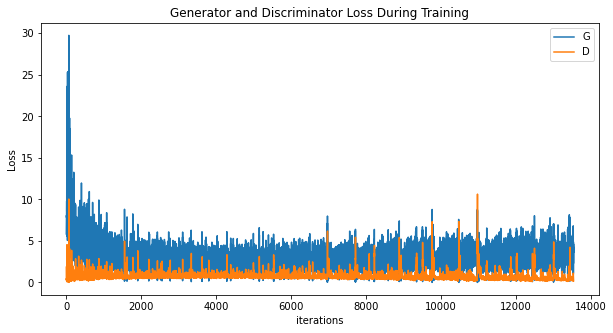

In [23]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

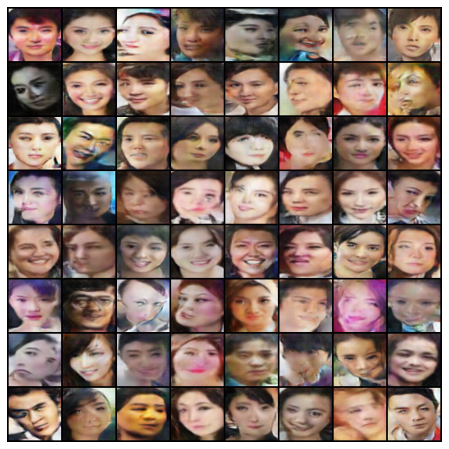

In [24]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

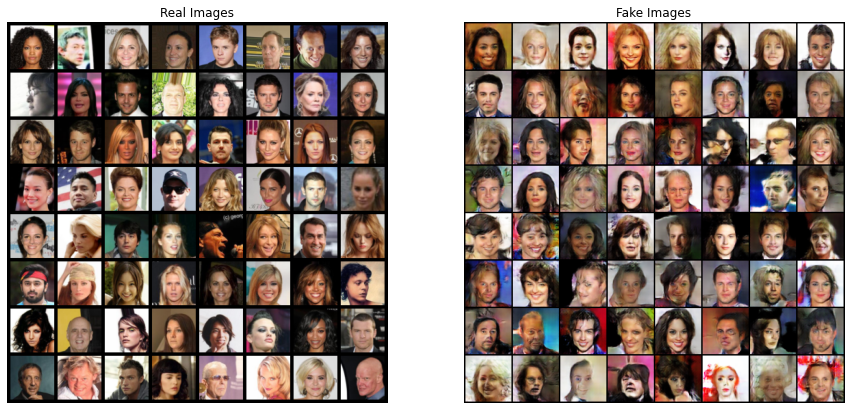

In [14]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()